In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Google Colab Directories

In [ ]:
# Define directories
train_image_dir = '/content/drive/MyDrive/VOC2012/train/images'
train_mask_dir = '/content/drive/MyDrive/VOC2012/train/masks'
val_image_dir = '/content/drive/MyDrive/VOC2012/val/images'
val_mask_dir = '/content/drive/MyDrive/VOC2012/val/masks'

Desktop Directories

In [1]:
# Define directories
train_image_dir = 'C:/Users/HP/Desktop/My Papers/Conferences/FCN8/Data/Train/Images'
train_mask_dir = 'C:/Users/HP/Desktop/My Papers/Conferences/FCN8/Data/Train/Masks'
val_image_dir = 'C:/Users/HP/Desktop/My Papers/Conferences/FCN8/Data/Val/Images'
val_mask_dir = 'C:/Users/HP/Desktop/My Papers/Conferences/FCN8/Data/Val/Masks'

In [2]:
import os
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from PIL import Image


# Image dimensions
img_height, img_width, channels = 224, 224, 3  # You can adjust this based on your model requirements

# Create data generators
train_datagen = ImageDataGenerator(rescale=1./255)
val_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_image_dir,
    target_size=(img_height, img_width),
    batch_size=16,
    class_mode=None,  # We use None for masks
    shuffle=False
)

train_mask_generator = train_datagen.flow_from_directory(
    train_mask_dir,
    target_size=(img_height, img_width),
    batch_size=16,
    class_mode=None,
    color_mode='grayscale',  # Ensure masks are loaded in grayscale
    shuffle=False
)

val_generator = val_datagen.flow_from_directory(
    val_image_dir,
    target_size=(img_height, img_width),
    batch_size=16,
    class_mode=None,
    shuffle=False
)

val_mask_generator = val_datagen.flow_from_directory(
    val_mask_dir,
    target_size=(img_height, img_width),
    batch_size=16,
    class_mode=None,
    color_mode='grayscale',
    shuffle=False
)

# Combine image and mask generators
train_combined_generator = zip(train_generator, train_mask_generator)
val_combined_generator = zip(val_generator, val_mask_generator)


Found 1477 images belonging to 20 classes.
Found 1477 images belonging to 20 classes.
Found 1449 images belonging to 20 classes.
Found 1449 images belonging to 20 classes.


In [3]:
def check_loaded_masks(generator, num_samples=5):
  for i in range(num_samples):
    images, masks = next(generator)

    print(f"Raw Mask Pixel Values: {masks[0]}")
check_loaded_masks(train_combined_generator)

Raw Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]
Raw Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]
Raw Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]
Raw Mask Pixe

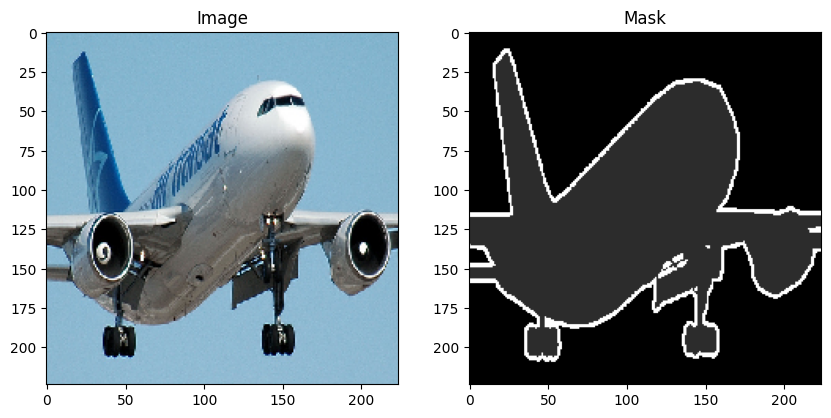

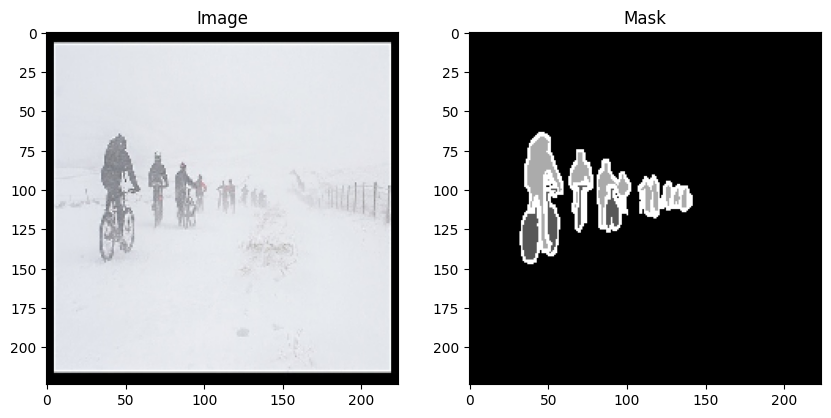

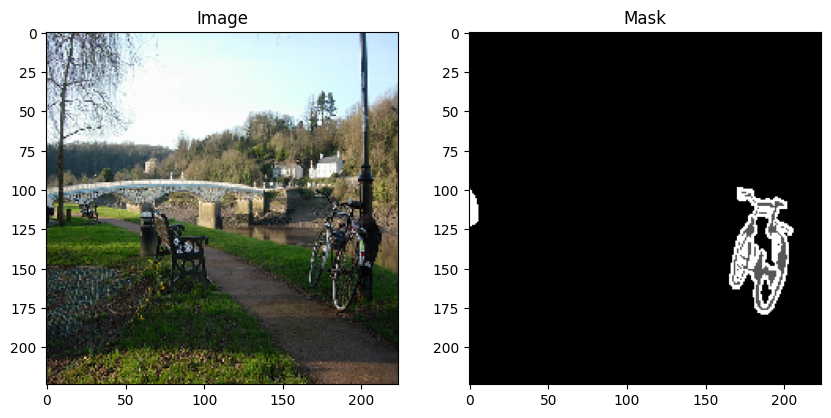

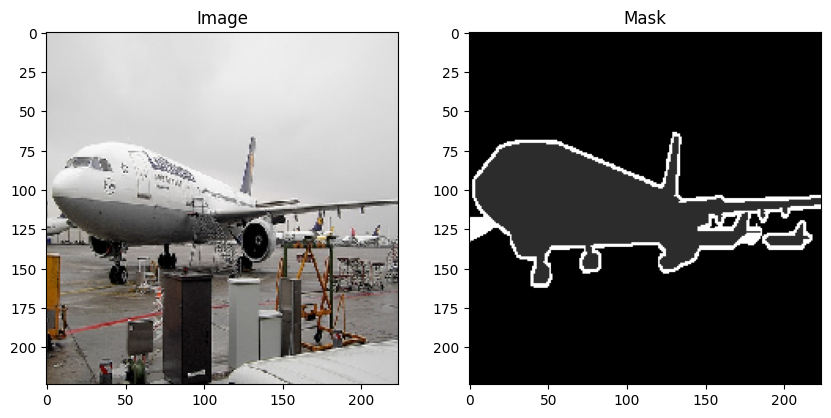

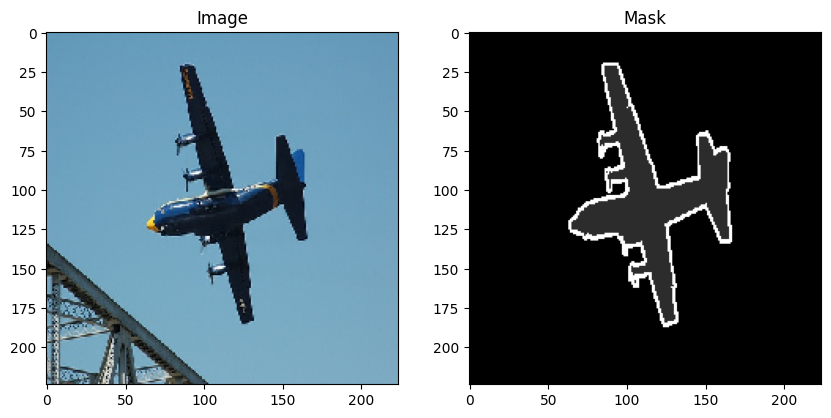

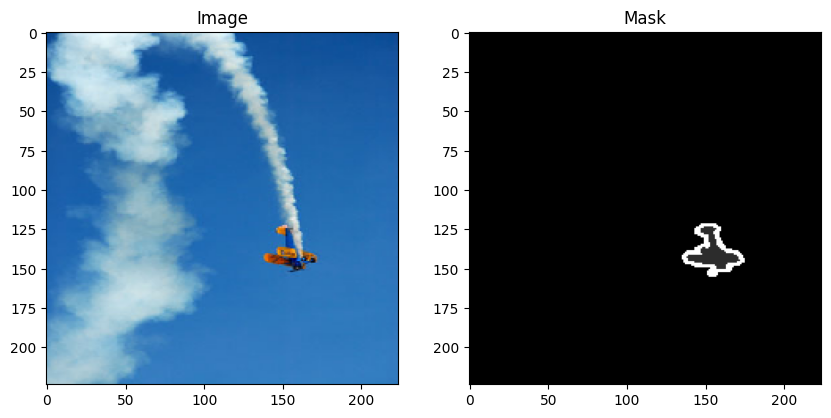

In [4]:
# Visualize a few samples
def visualize_samples(generator, num_samples=3):
    for i in range(num_samples):
        image, mask = next(generator)
        plt.figure(figsize=(10, 5))

        plt.subplot(1, 2, 1)
        plt.imshow(image[0])
        plt.title('Image')

        plt.subplot(1, 2, 2)
        plt.imshow(mask[0].reshape(img_height, img_width), cmap='gray')
        plt.title('Mask')

        plt.show()

# Visualize training samples
visualize_samples(train_combined_generator)

# Visualize validation samples
visualize_samples(val_combined_generator)

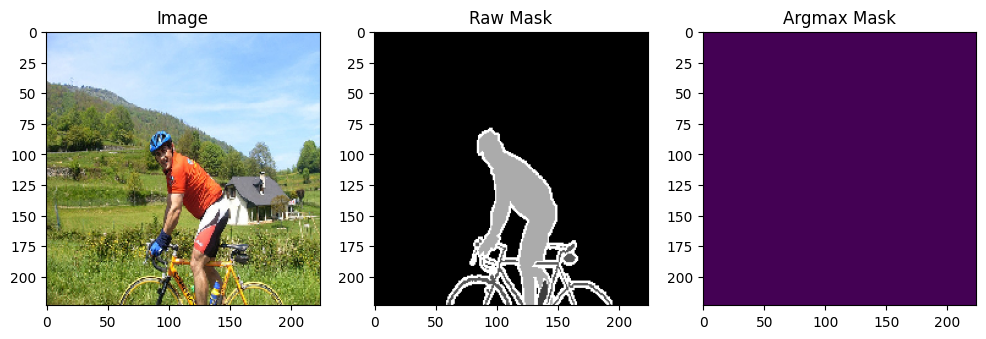

Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]


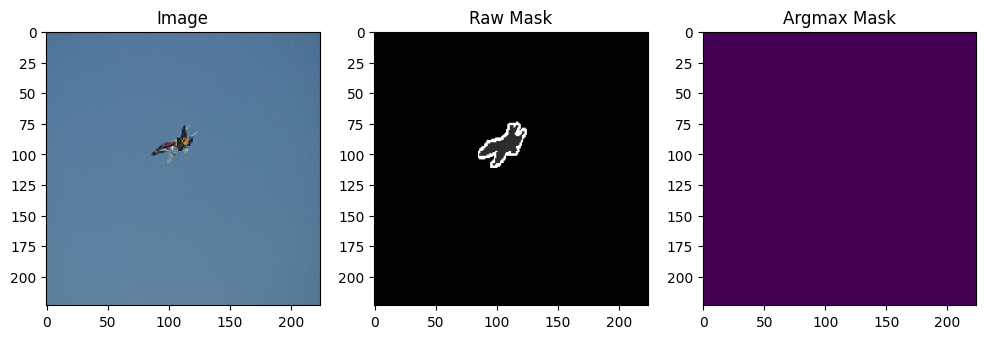

Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]


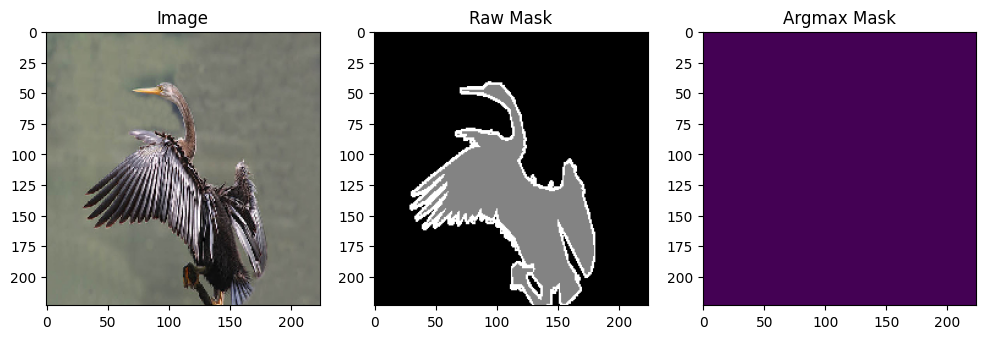

Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]


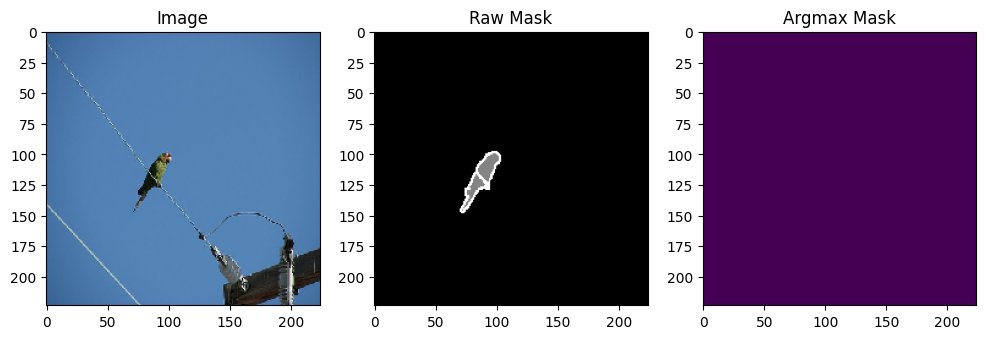

Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]


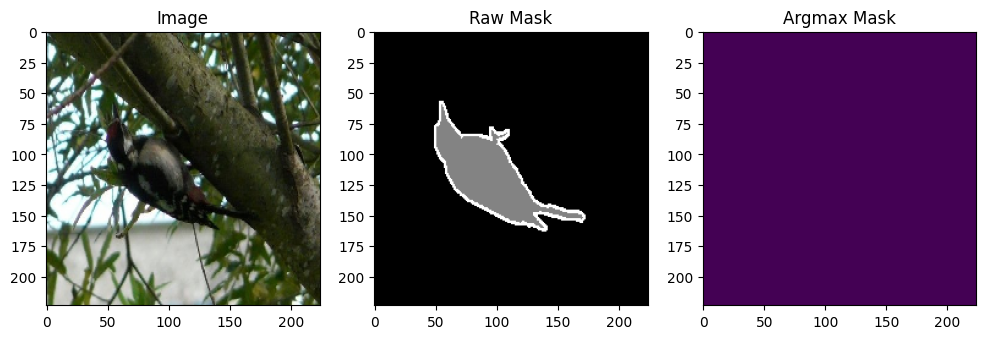

Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]


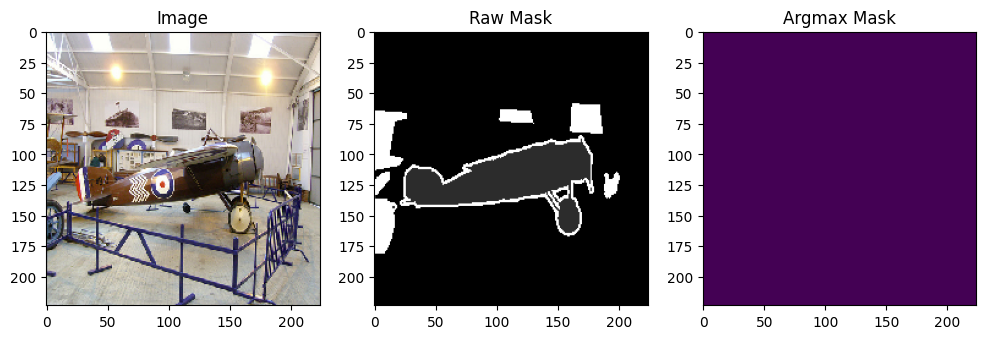

Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]


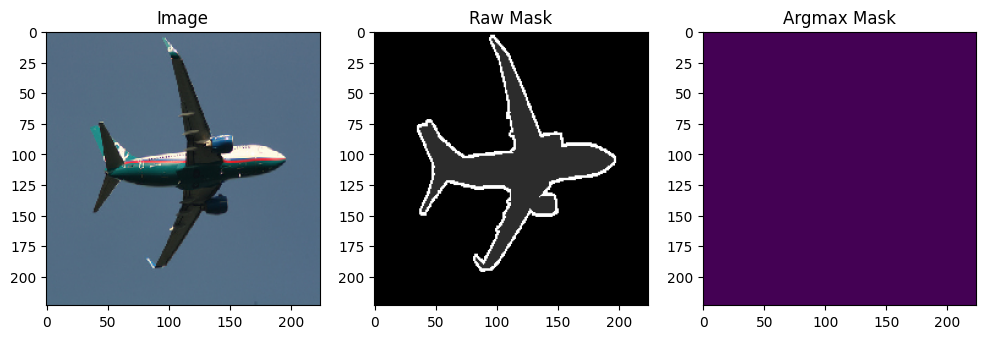

Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]


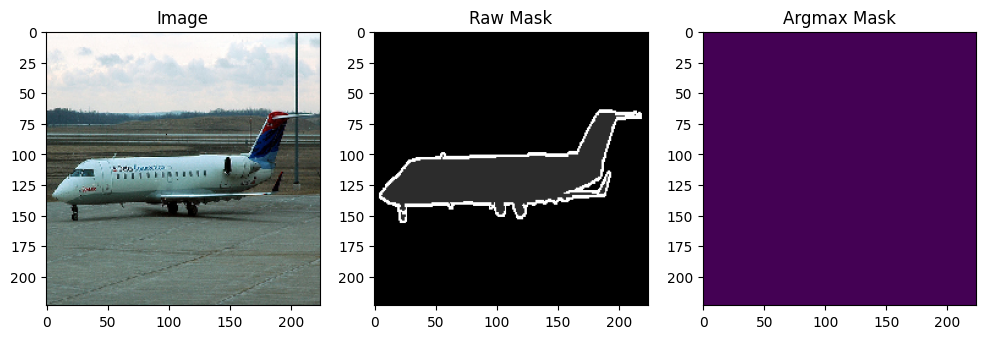

Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]


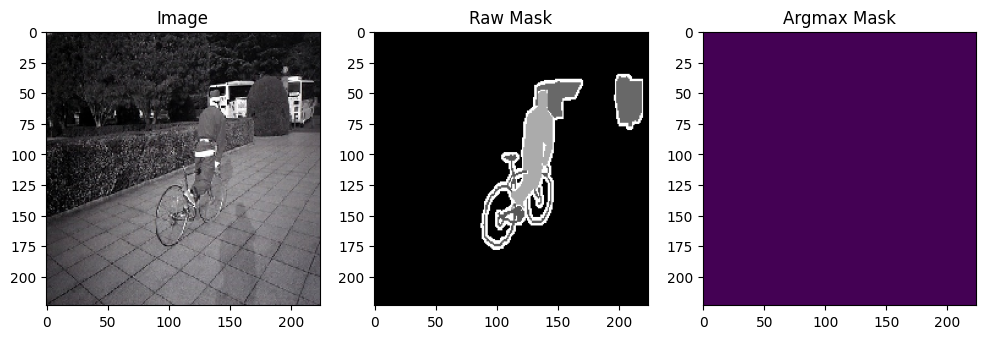

Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]


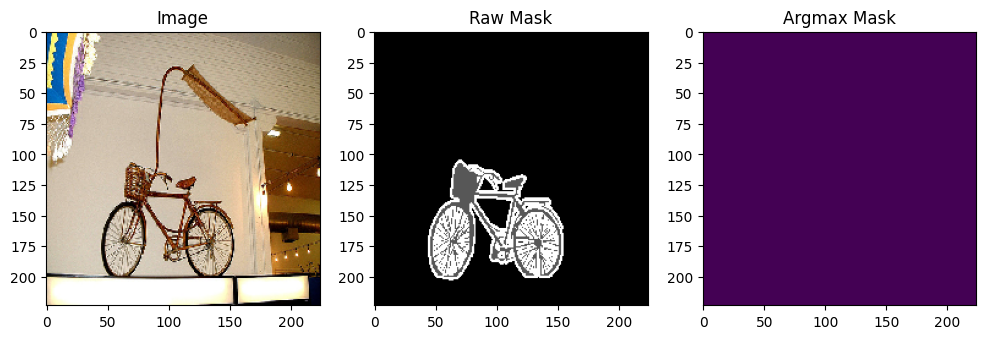

Mask Pixel Values: [[[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]]


In [5]:
import numpy as np

# Visualize a few samples with color-coded masks and print pixel values
def visualize_samples(generator, mask_generator, num_samples=5):
    for i in range(num_samples):
        image = next(generator)
        mask = next(mask_generator)

        plt.figure(figsize=(12, 6))

        plt.subplot(1, 3, 1)
        plt.imshow(image[0])
        plt.title('Image')

        plt.subplot(1, 3, 2)
        plt.imshow(mask[0].reshape(img_height, img_width), cmap='gray')
        plt.title('Raw Mask')

        plt.subplot(1, 3, 3)
        plt.imshow(np.argmax(mask[0], axis=-1), cmap='viridis')  # Convert one-hot to integer for visualization
        plt.title('Argmax Mask')

        plt.show()

        # Print pixel values from the mask
        print(f"Mask Pixel Values: {mask[0]}")

# Visualize training samples with color-coded masks and print pixel values
visualize_samples(train_generator, train_mask_generator)

# Visualize validation samples with color-coded masks and print pixel values
visualize_samples(val_generator, val_mask_generator)


In [6]:
from tensorflow.keras import layers
from tensorflow.keras.applications import VGG16

# Load pre-trained VGG-16 model with ImageNet weights (excluding top layers)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
base_model.summary()
# Freeze the weights of the VGG-16 layers
base_model.trainable = False

# Output feature maps from various layers in VGG-16 for skip connections
skip1 = base_model.get_layer('block3_pool').output
skip2 = base_model.get_layer('block4_pool').output
skip3 = base_model.get_layer('block5_pool').output

# Encoder output (final feature map)
encoder_output = skip3




Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [7]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import UpSampling2D, Concatenate, Conv2D

# Decoder
u1 = UpSampling2D((2,2), interpolation='bilinear')(skip3)
d1 = Concatenate()([u1, skip2])
u2 = UpSampling2D((2,2), interpolation='bilinear')(d1)
d2 = Concatenate()([u2, skip1])
# Final classification layer
u3 = UpSampling2D((8,8), interpolation='bilinear')(d2)
output = Conv2D(20, (1,1), activation='softmax')(u3)

# Create the FCN8 model
fcn8_model = Model(inputs=base_model.input, outputs=output)

# Display a summary of the model architecture
fcn8_model.summary()


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 block1_conv1 (Conv2D)       (None, 224, 224, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 block1_conv2 (Conv2D)       (None, 224, 224, 64)         36928     ['block1_conv1[0][0]']        
                                                                                                  
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)         0         ['block1_conv2[0][0]']        
                                                                                              

                                                                     'block4_pool[0][0]']         
                                                                                                  
 up_sampling2d_1 (UpSamplin  (None, 28, 28, 1024)         0         ['concatenate[0][0]']         
 g2D)                                                                                             
                                                                                                  
 concatenate_1 (Concatenate  (None, 28, 28, 1280)         0         ['up_sampling2d_1[0][0]',     
 )                                                                   'block3_pool[0][0]']         
                                                                                                  
 up_sampling2d_2 (UpSamplin  (None, 224, 224, 1280)       0         ['concatenate_1[0][0]']       
 g2D)                                                                                             
          

In [8]:
u3.shape

TensorShape([None, 224, 224, 1280])

1/1 [==============================] - 32s 32s/step


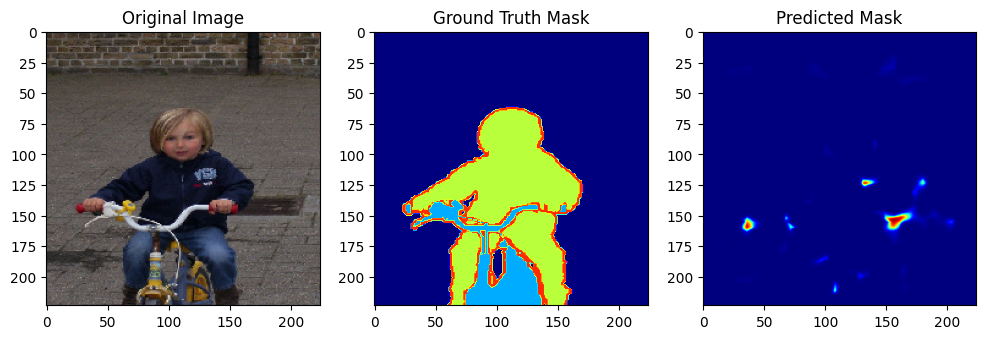

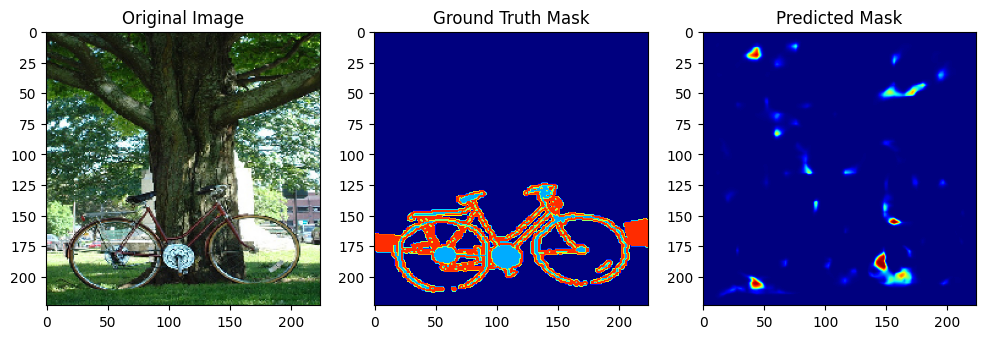

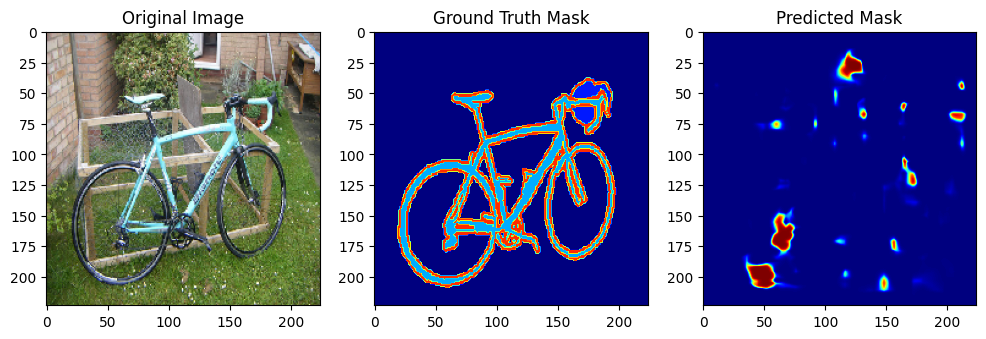

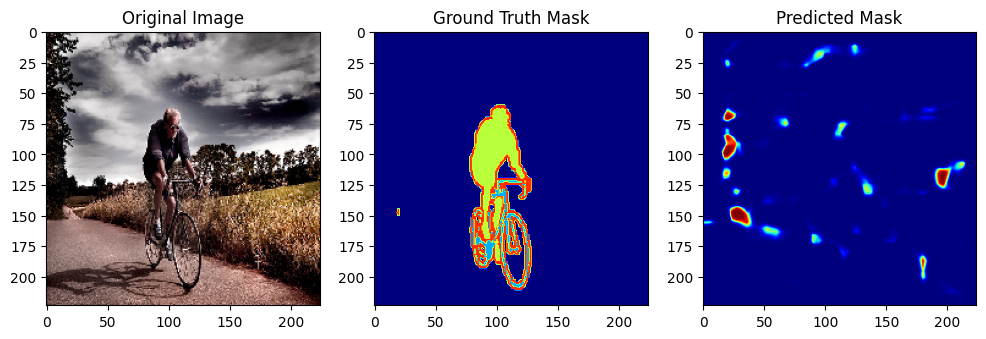

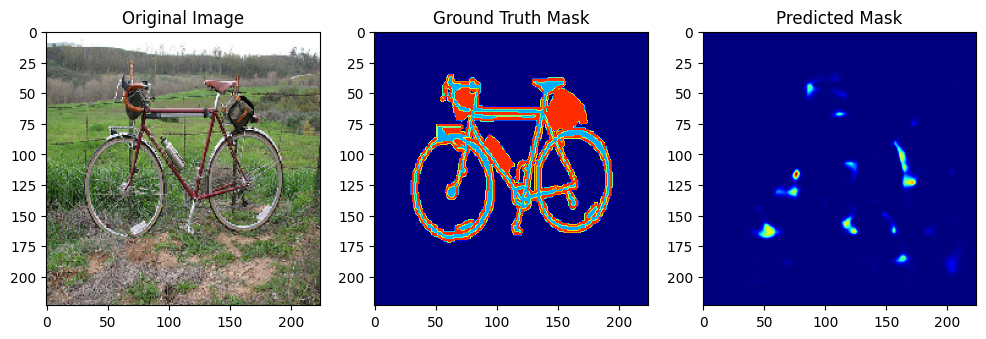

...

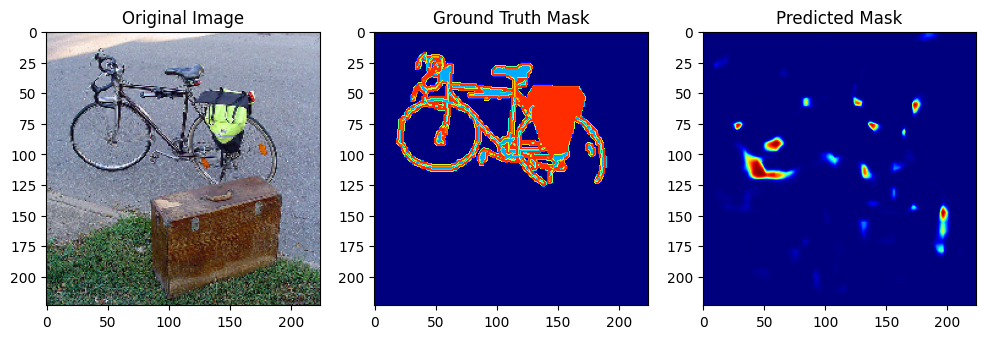

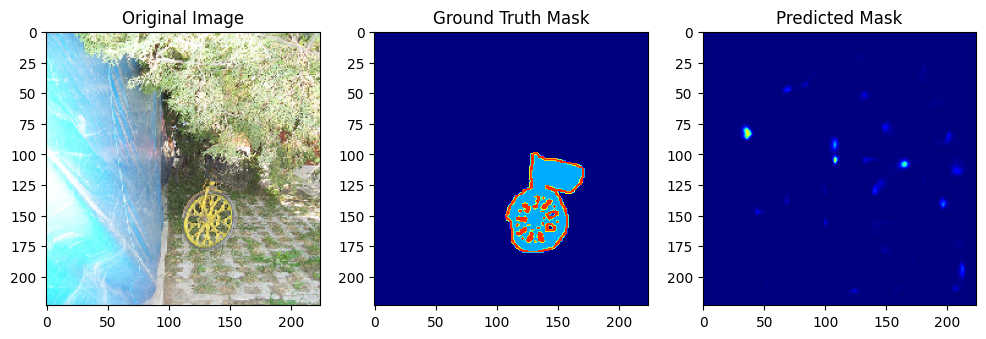

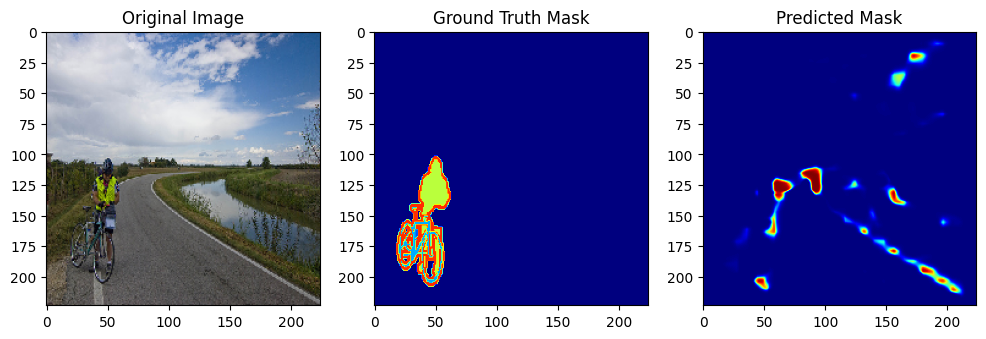

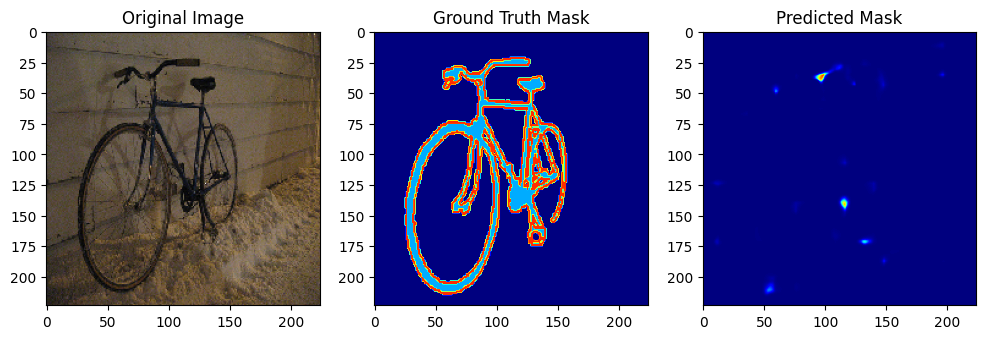

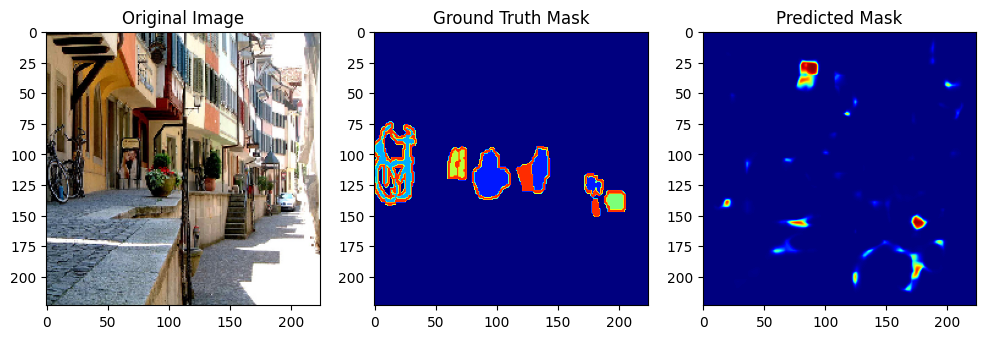

1/1 [==============================] - 20s 20s/step


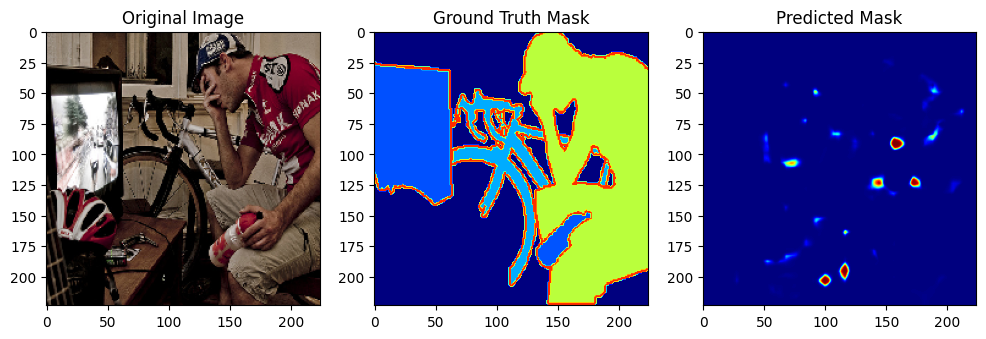

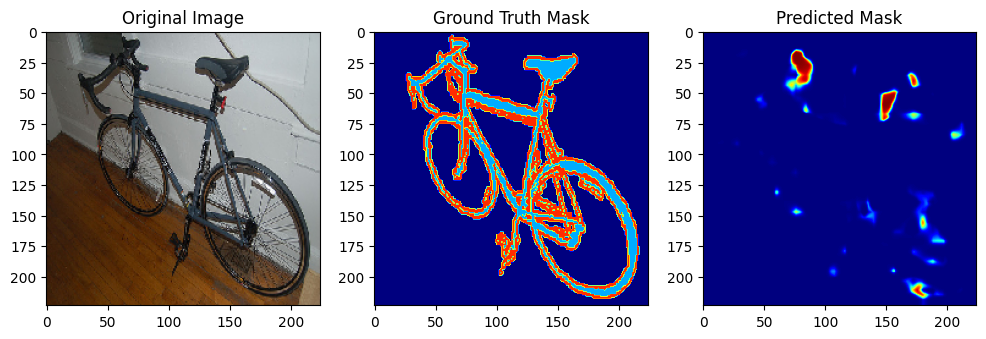

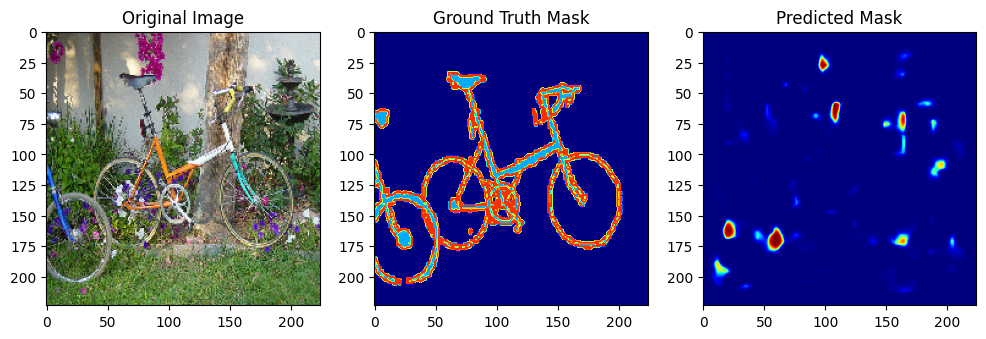

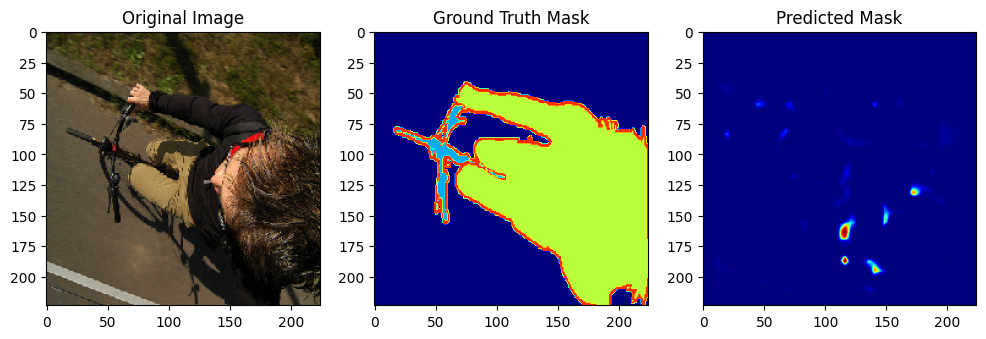

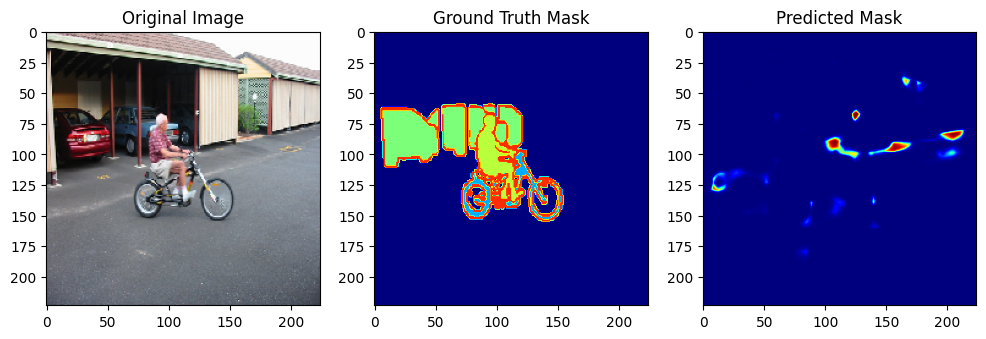

...

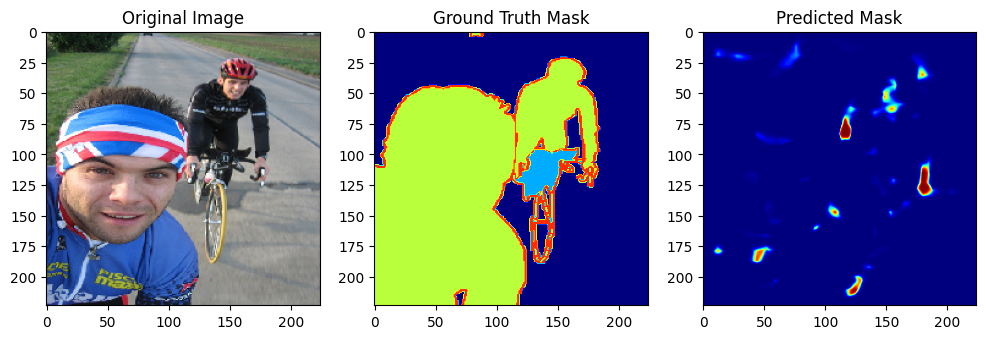

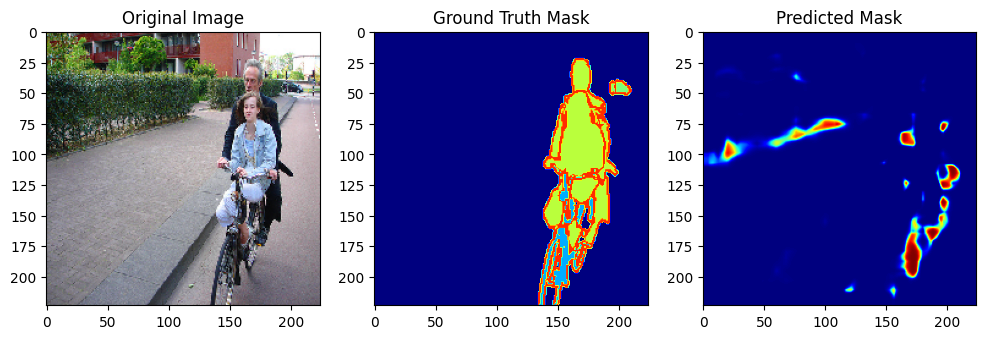

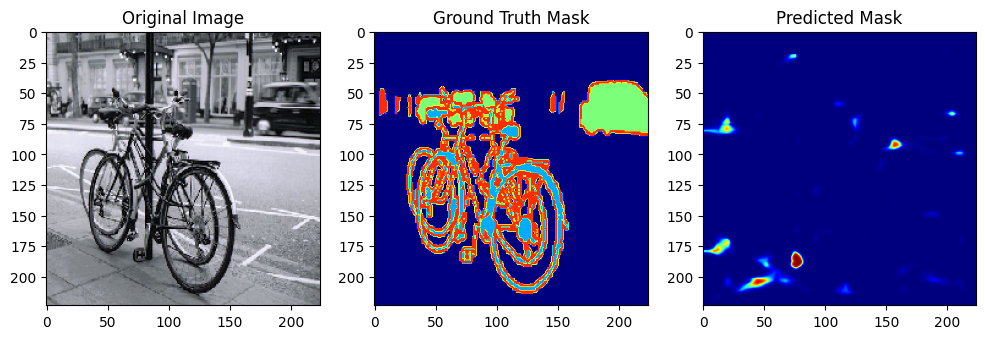

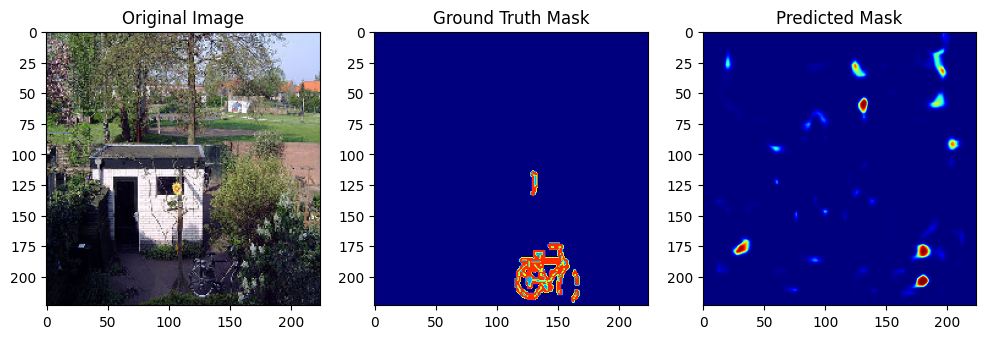

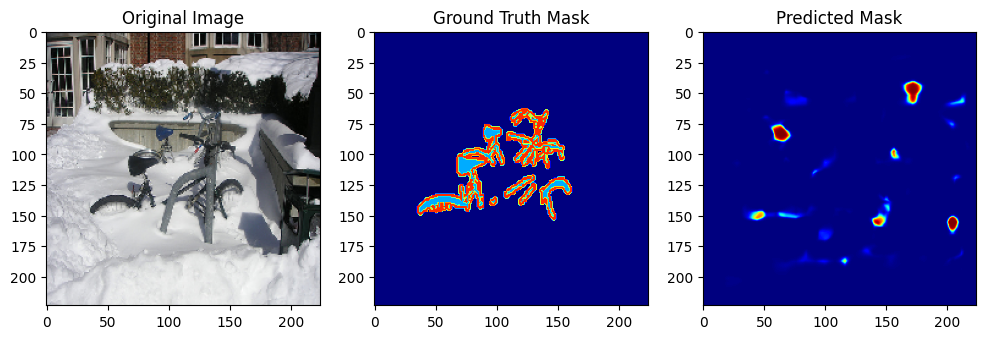

1/1 [==============================] - 16s 16s/step


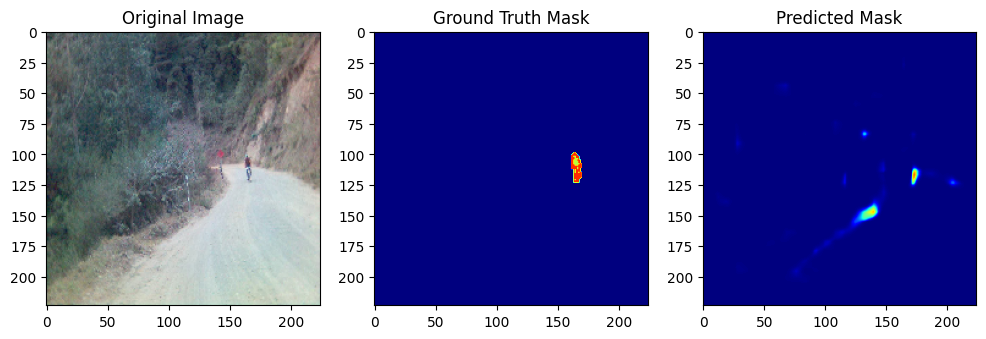

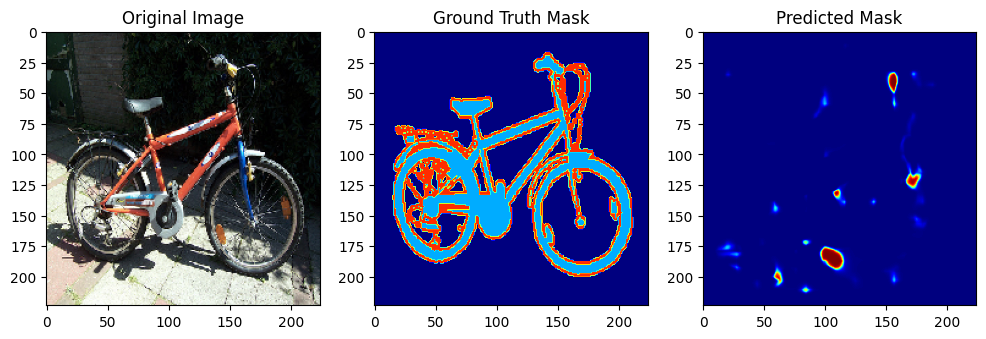

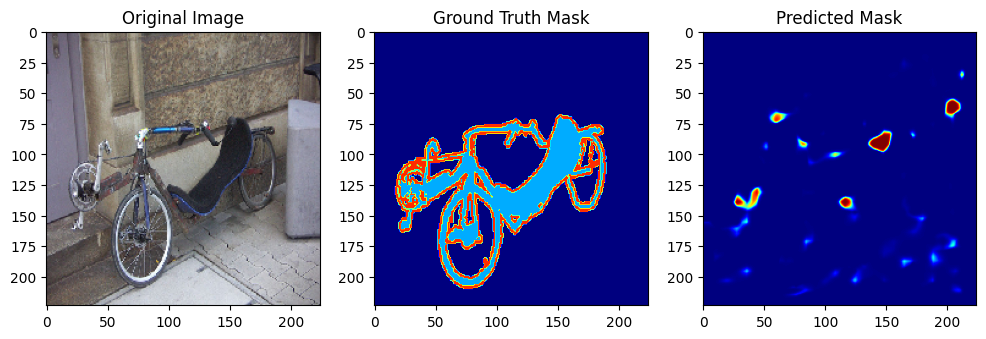

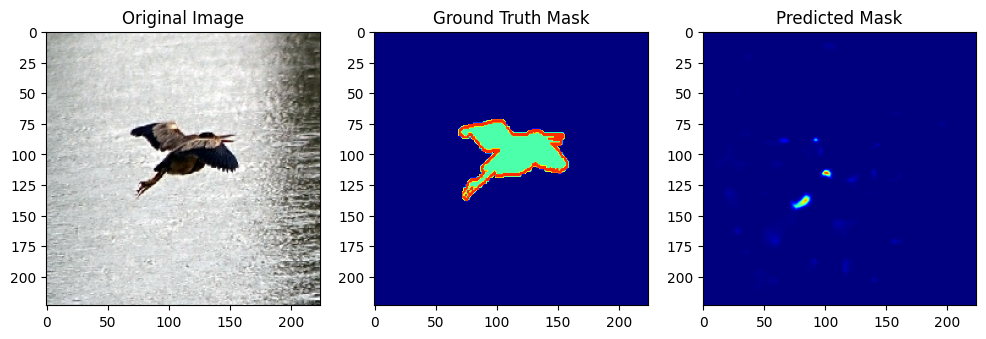

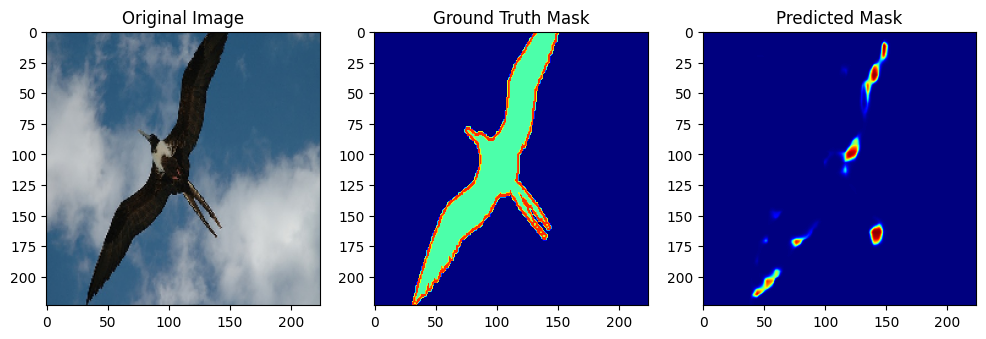

...

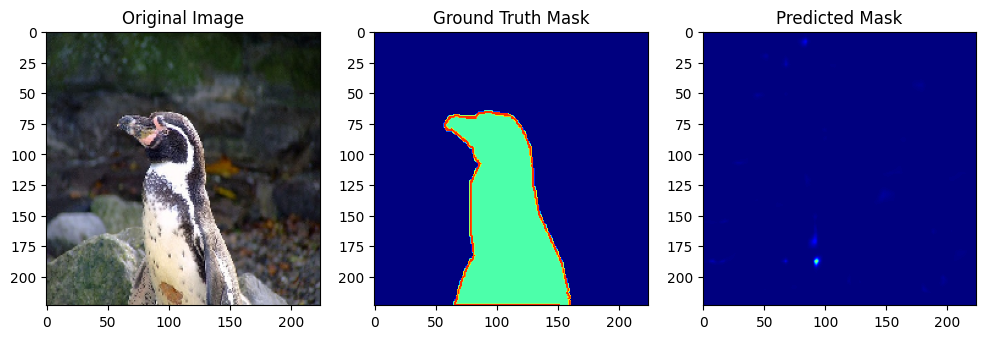

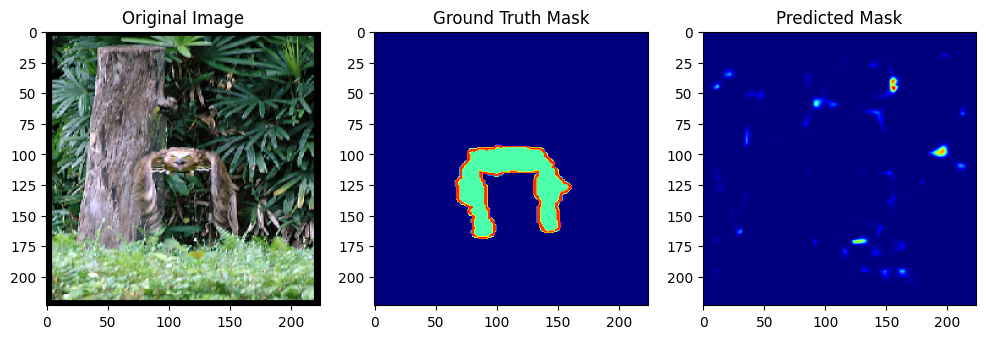

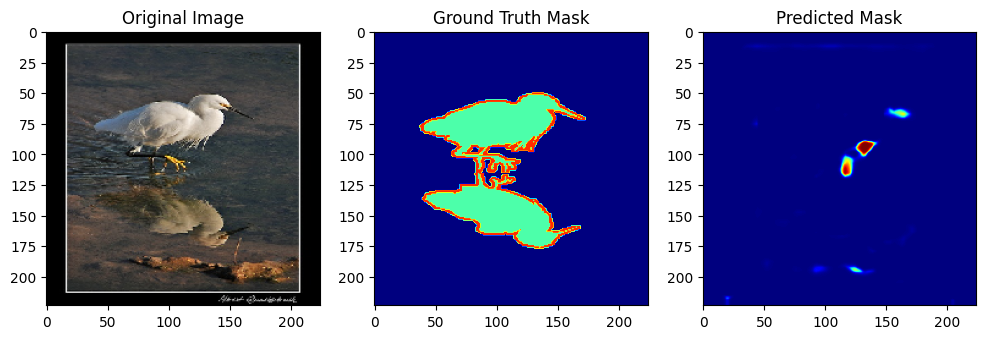

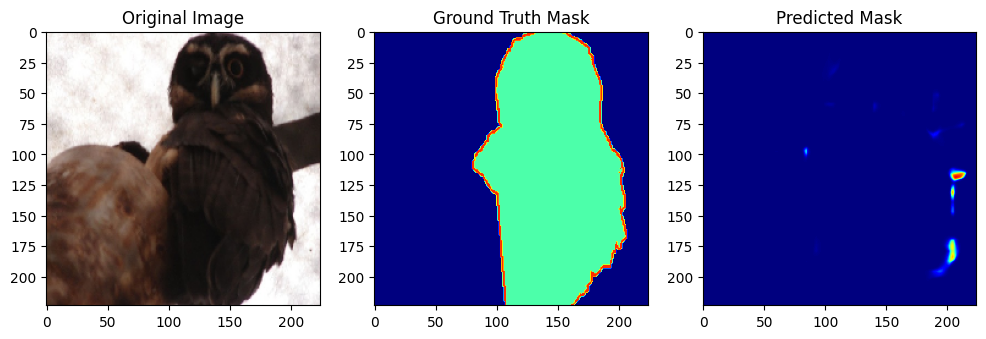

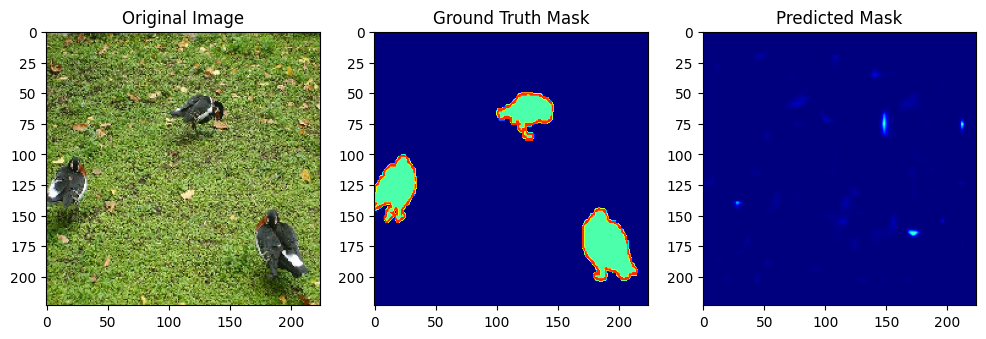

1/1 [==============================] - 14s 14s/step


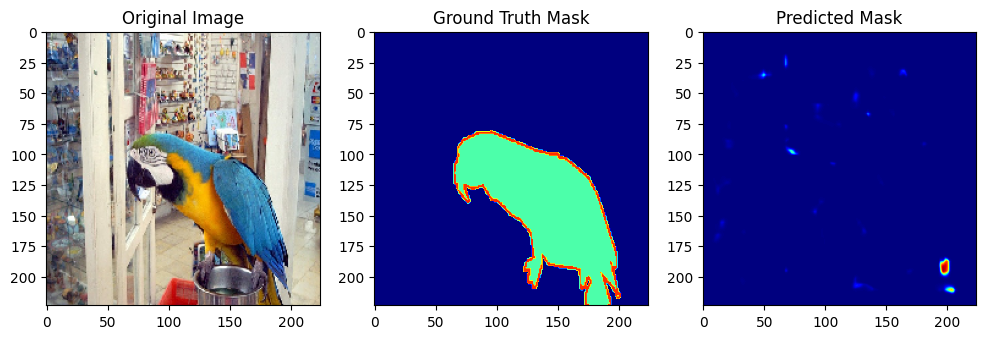

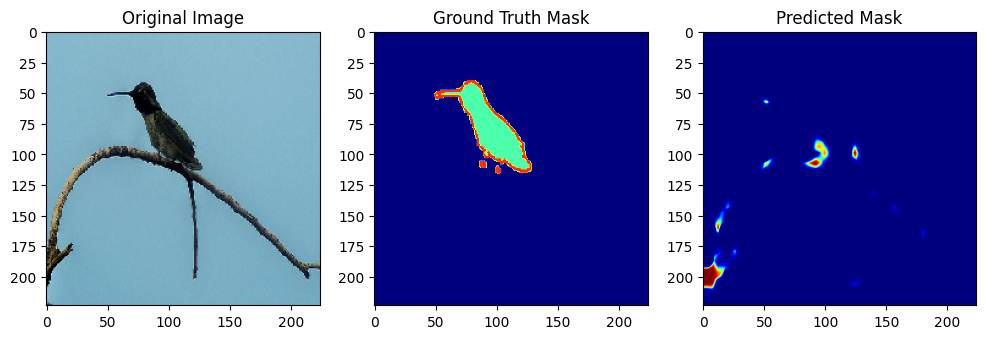

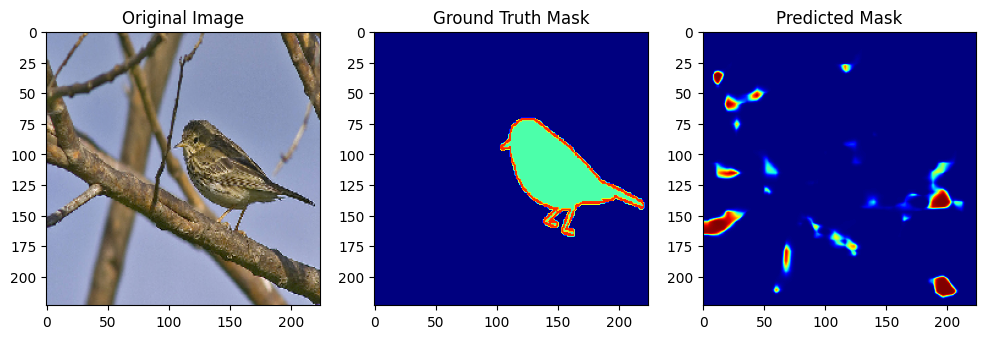

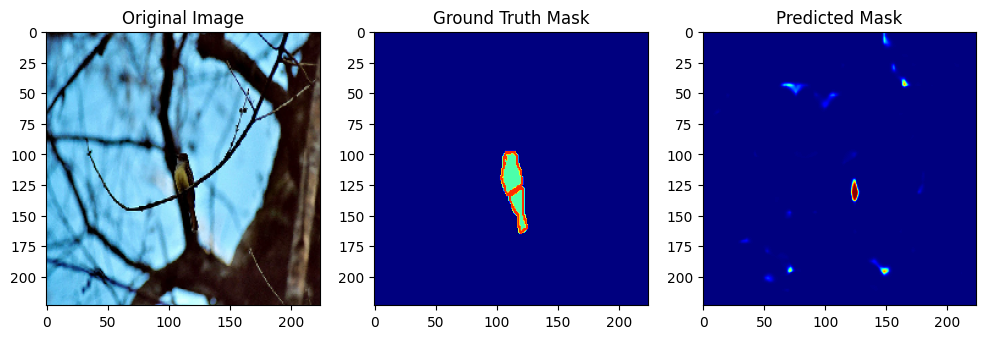

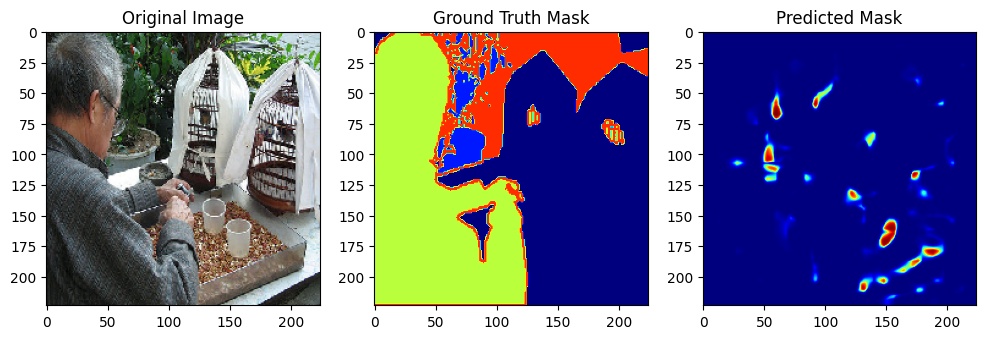

...

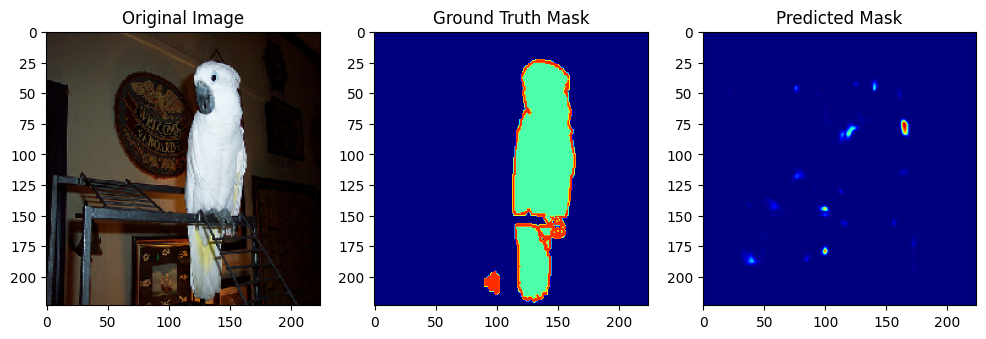

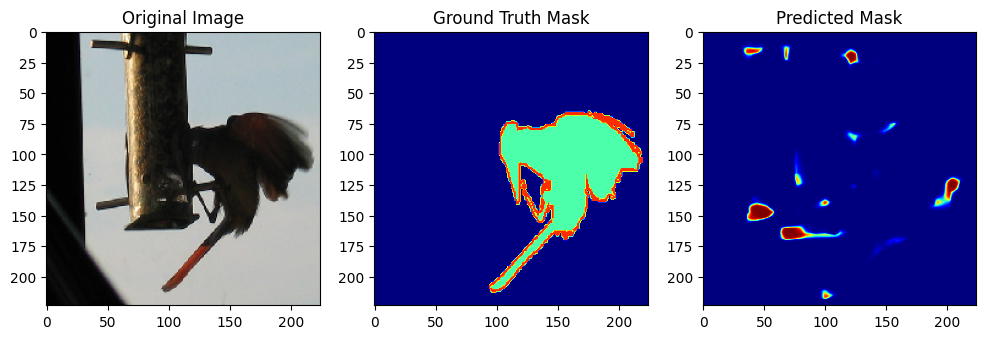

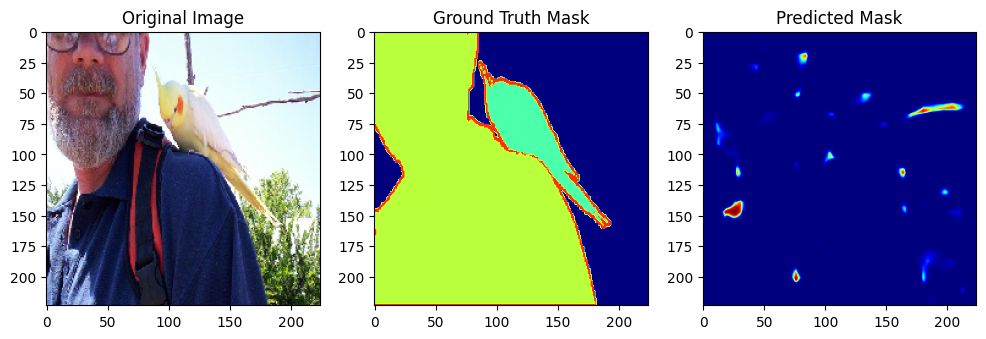

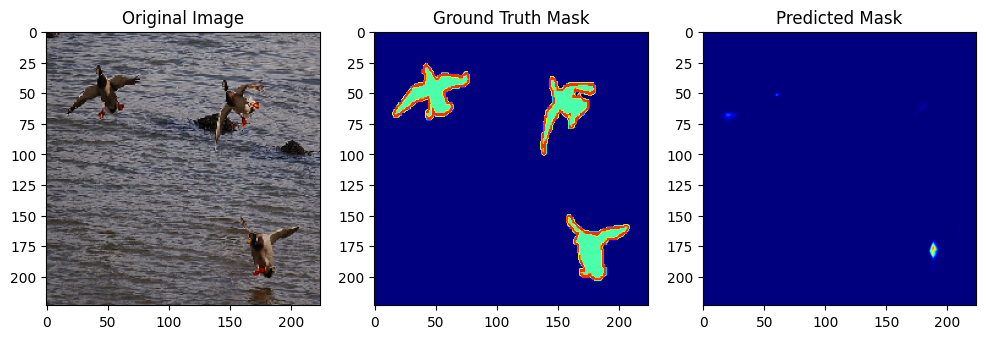

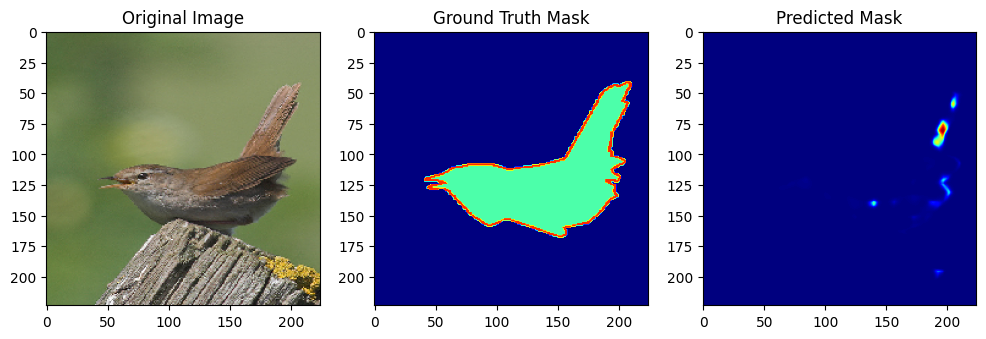

1/1 [==============================] - 10s 10s/step


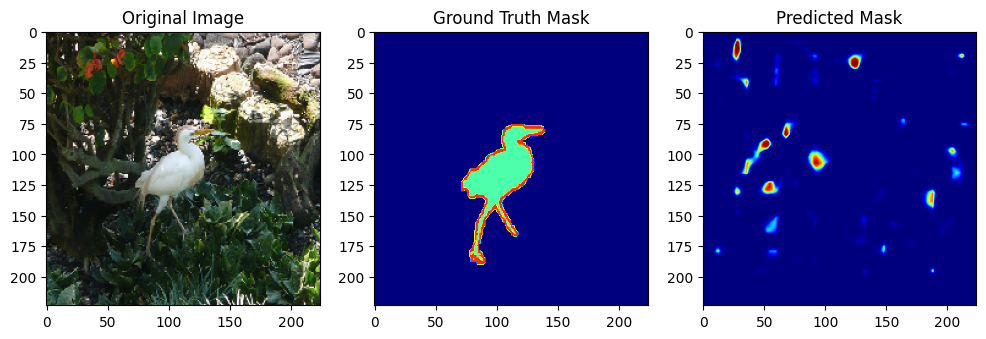

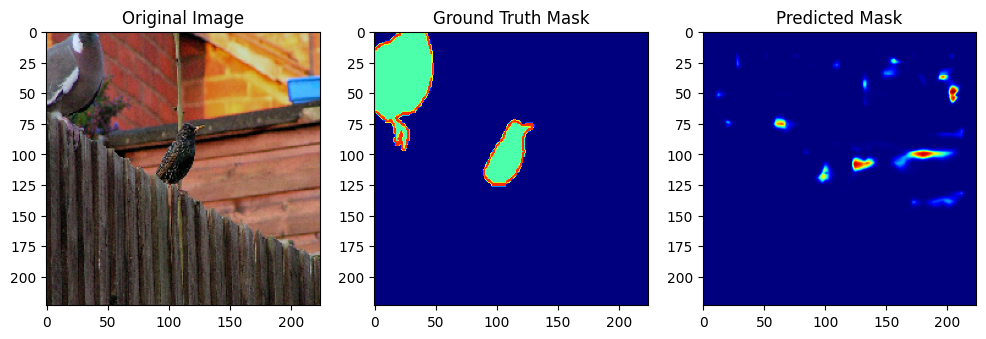

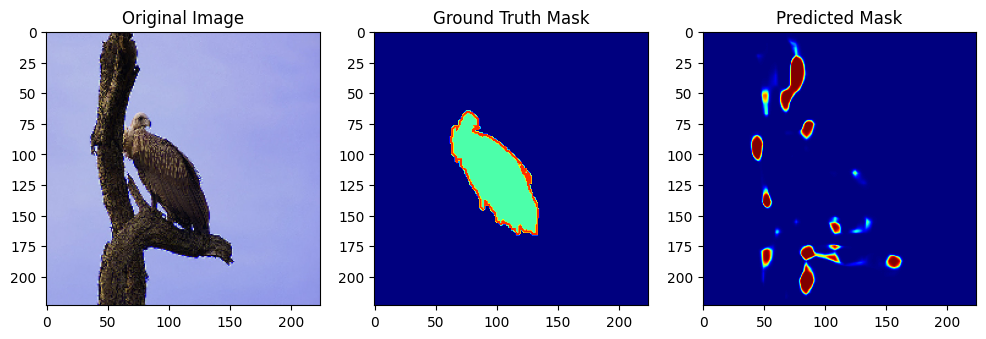

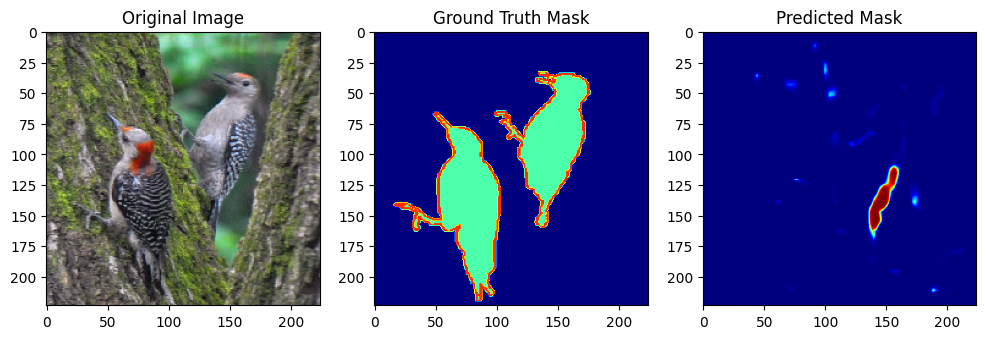

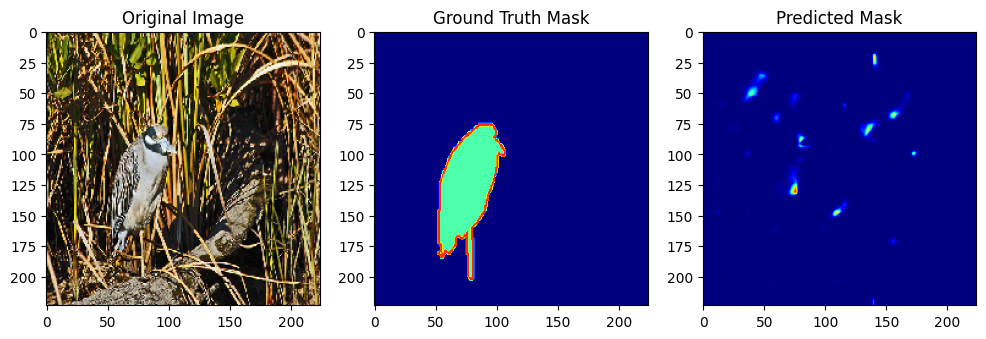

...

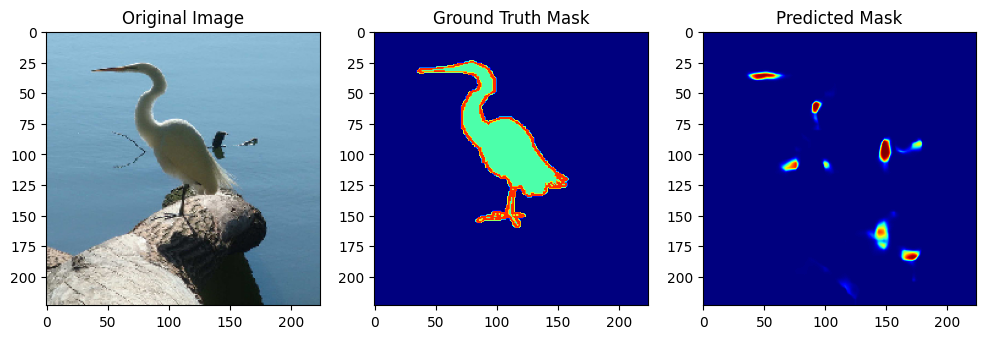

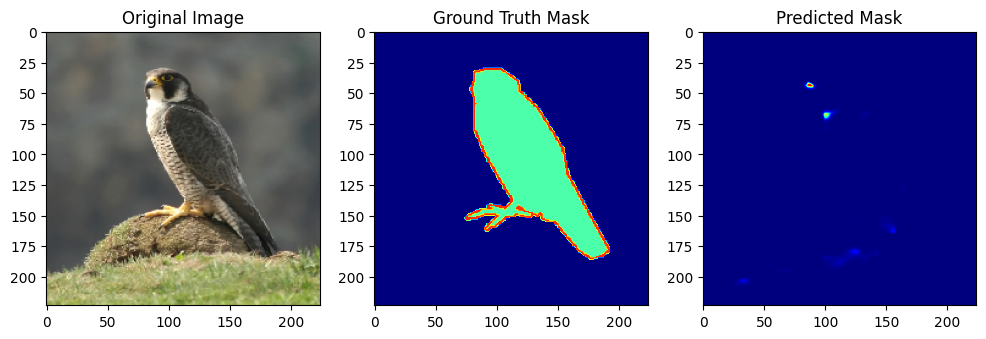

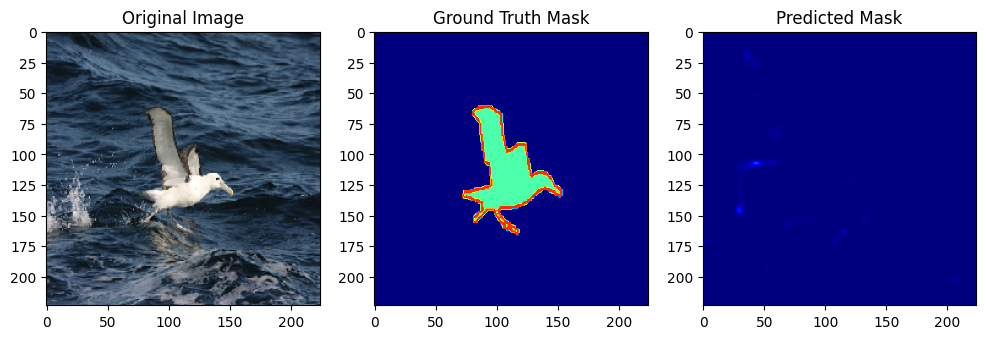

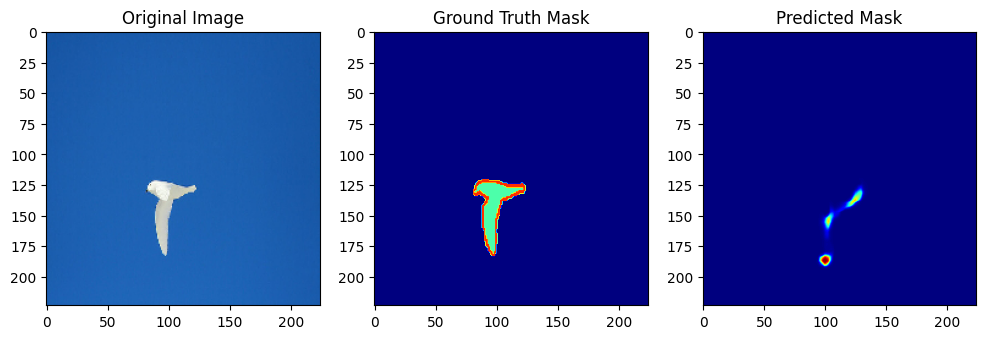

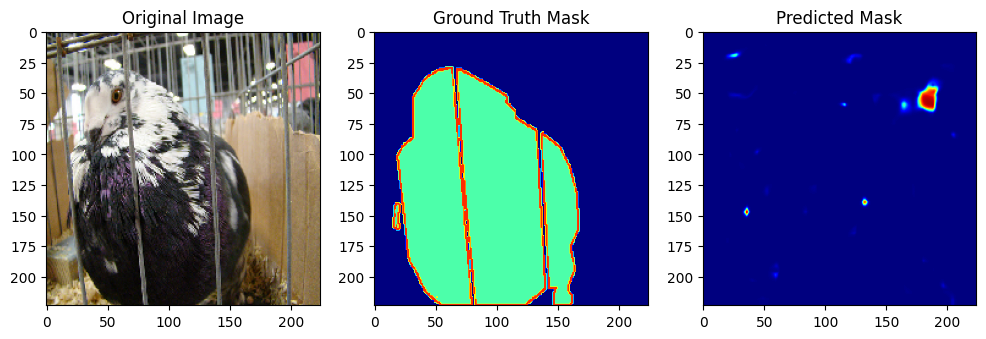

In [9]:
import numpy as np
import matplotlib.pyplot as plt

# Function to make predictions and visualize them
def visualize_predictions(model, data_generator, num_samples=5):
    for i, (images, masks) in enumerate(data_generator):
        if i == num_samples:
            break

        # Make predictions
        predictions = model.predict(images)

        # Plot original image, ground truth mask, and predicted mask
        for j in range(images.shape[0]):
            plt.figure(figsize=(12, 4))

            plt.subplot(1, 3, 1)
            plt.imshow(images[j])
            plt.title('Original Image')

            plt.subplot(1, 3, 2)
            plt.imshow(masks[j][:,:,0], cmap='jet', vmin=0, vmax=1)
            plt.title('Ground Truth Mask')

            plt.subplot(1, 3, 3)
            plt.imshow(predictions[j][:,:,0], cmap='jet', vmin=0, vmax=1)
            plt.title('Predicted Mask')

            plt.show()

# Assuming you have a test data generator (test_combined_generator) for visualization
visualize_predictions(fcn8_model, val_combined_generator, num_samples=5)

In [ ]:
# Compile the model as needed
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy

fcn8_model.compile(optimizer=Adam(learning_rate=1e-4), loss=SparseCategoricalCrossentropy(), metrics=['accuracy'])

In [ ]:
import math
train_steps = math.ceil(1477/16)
val_steps=math.ceil(1449/16)
num_epochs=5
# Assuming you have a `train_steps` and `val_steps` variables defined based on your dataset size
history = fcn8_model.fit(train_combined_generator, steps_per_epoch=train_steps,
                         validation_data=val_combined_generator, validation_steps=val_steps,
                         epochs=num_epochs)


Epoch 1/5
16/93 [====>.........................] - ETA: 16s - loss: 4.0709 - accuracy: 0.2442

KeyboardInterrupt: 

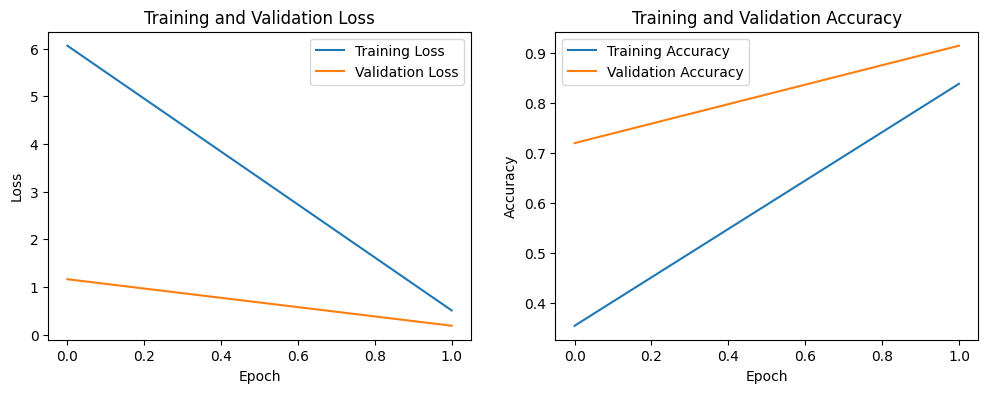

In [ ]:
import matplotlib.pyplot as plt

# Plot training loss
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# Plot training accuracy
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.show()


In [ ]:
# import numpy as np
# import matplotlib.pyplot as plt

# # Function to make predictions and visualize them
# def visualize_predictions(model, data_generator, num_samples=5):
#     for i, (images, masks) in enumerate(data_generator):
#         if i == num_samples:
#             break

#         # Make predictions
#         predictions = model.predict(images)

#         # Plot original image, ground truth mask, and predicted mask
#         for j in range(images.shape[0]):
#             plt.figure(figsize=(12, 4))

#             plt.subplot(1, 3, 1)
#             plt.imshow(images[j])
#             plt.title('Original Image')

#             plt.subplot(1, 3, 2)
#             plt.imshow(np.argmax(masks[j], axis=-1), cmap='jet', vmin=0, vmax=model.output_shape[-1]-1)
#             plt.title('Ground Truth Mask')

#             plt.subplot(1, 3, 3)
#             plt.imshow(np.argmax(predictions[j], axis=-1), cmap='jet', vmin=0, vmax=model.output_shape[-1]-1)
#             plt.title('Predicted Mask')

#             plt.show()

# # Assuming you have a test data generator (test_combined_generator) for visualization
# visualize_predictions(fcn8_model, val_combined_generator, num_samples=5)


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Function to make predictions and visualize them
def visualize_predictions(model, data_generator, num_samples=5):
    for i, (images, masks) in enumerate(data_generator):
        if i == num_samples:
            break

        # Make predictions
        predictions = model.predict(images)

        # Plot original image, ground truth mask, and predicted mask
        for j in range(images.shape[0]):
            plt.figure(figsize=(12, 4))

            plt.subplot(1, 3, 1)
            plt.imshow(images[j])
            plt.title('Original Image')

            plt.subplot(1, 3, 2)
            plt.imshow(masks[j][:,:,0], cmap='jet', vmin=0, vmax=1)
            plt.title('Ground Truth Mask')

            plt.subplot(1, 3, 3)
            plt.imshow(predictions[j][:,:,0], cmap='jet', vmin=0, vmax=1)
            plt.title('Predicted Mask')

            plt.show()

# Assuming you have a test data generator (test_combined_generator) for visualization
visualize_predictions(fcn8_model, val_combined_generator, num_samples=5)
